In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.signal import fftconvolve, convolve, unit_impulse
import IPython
import pyroomacoustics as pra
from pyroomacoustics.doa import circ_dist
from scipy import signal
from scipy.io.wavfile import write
# import rir_generator as rir
import noisereduce as nr
import sounddevice as sd
from scipy import stats
import math
import librosa
import librosa.display

In [2]:
# Functions 
def keep_last(sig_arr, length, fs=44100):
    samples = int(fs*length)
    print(f'Samples: {samples}')
    sig_len = len(sig_arr[0])
    crop_start = sig_len - samples

    new_sig_arr = np.zeros((3, samples))
    i = 0
    for sig in sig_arr:
        new_sig_arr[i] = sig[crop_start:(crop_start+samples)]
        i += 1
    return new_sig_arr

def crop_audio(sig_arr, start, length, fs=44100):
    samples = int(fs*length)
    crop_start = int(fs*start)
    print(f'Crop start: {crop_start}')
    print(f'Samples: {samples}')

    new_sig_arr = np.zeros((3, samples))
    i = 0
    for sig in sig_arr:
        new_sig_arr[i] = sig[crop_start:(crop_start+samples)]
        i += 1
    return new_sig_arr

def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)

In [3]:
# Source signal
audio_file="./SyncRecordings/rec_from_src_usb_mic/new_clap_source.wav"
fs, source_signal = wavfile.read(audio_file)
snr_pwr = signaltonoise(source_signal)
snr_pwr

array(5.66313801e-05)

In [4]:
source_signal, fs = librosa.load(audio_file, sr=None)
fs

44100

In [73]:
# Noise
distance = 2.2319
real_azimuth = 311 #From center of mic array

# snr_db = 10*np.log10(snr_pwr)
snr_db = 30
sigma2 = 10**(-snr_db / 10) / (4. * np.pi * distance)**2
sample_rate = fs
print(f'SNR (dB) = {snr_db}')
print(f'Sigma 2 = {sigma2}')

SNR (dB) = 30
Sigma 2 = 1.2712495364602787e-06


Absorption = 0.3220320336756547
Max order = 54


Text(0.5, 0.92, '3D Ice lab')

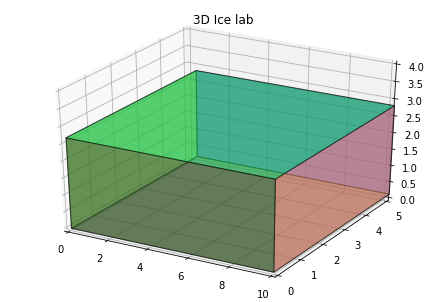

In [44]:
#  Reverberation and Setting up a room
rt60 = 0.38  # (From android RT app in lab)
room_dim = np.array([10., 5.3213, 2.7])

e_absorption, max_order = pra.inverse_sabine(rt60, room_dim)

print(f'Absorption = {e_absorption}')
print(f'Max order = {max_order}')

room = pra.ShoeBox(room_dim, absorption=e_absorption, fs=sample_rate, max_order=max_order, sigma2_awgn=sigma2)


fig, ax = room.plot()
ax.set_xlim([0, 10])
ax.set_ylim([0, 5])
ax.set_zlim([0, 4])
ax.set_title("3D Ice lab")

Text(0.5, 0.92, '3D Ice lab with microphones')

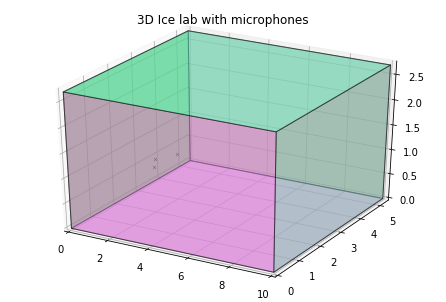

In [45]:
# R = np.array([[1.029, 1.527, 1.559],[2.491, 2.019, 3.022], [0.762, 0.762, 0.762]]) #Real world lab setup
# R = np.array([[1.0699, 1.5748, 1.6002],[2.567, 2.079, 3.082],[0.75565, 0.75565, 0.75565]]) #Updated lab setup
R = np.array([[1.0668, 1.5627, 1.5939],[2.8321, 2.3495, 3.3528],[0.75565, 0.75565, 0.75565]]) #Re-Updated lab setup
room.add_microphone_array(pra.MicrophoneArray(R, room.fs))
fig, ax = room.plot()
ax.set_title("3D Ice lab with microphones")

distance = 2.392241367420938
Source at: [3.37185 0.8509  0.775  ]


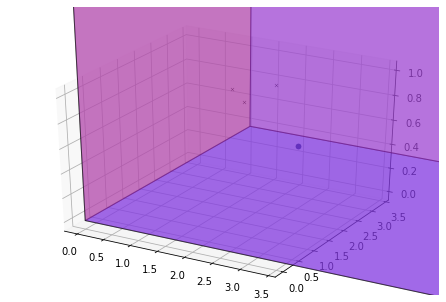

Simulating room...
room signals shape: (3, 5378222)
Done.


In [46]:
# Adding a source and running simulation

source_location = np.array([3.37185,0.8509, 0.775])

distance = np.sqrt((source_location[0]-R[0][1])**2 + (source_location[1]-R[1][1])**2 + (source_location[2]-R[2][1]**2))
print(f'distance = {distance}')

#Add a the source
room.add_source(source_location, signal=source_signal)
# room.add_source(source_location, signal=[0])
print(f'Source at: {source_location}')
fig, ax = room.plot()
plt.show()
# Run room simulation
print('Simulating room...')
room.simulate()
print(f'room signals shape: {room.mic_array.signals.shape}')
print('Done.')

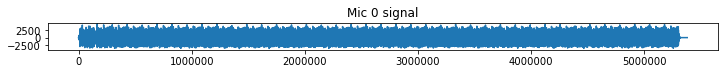

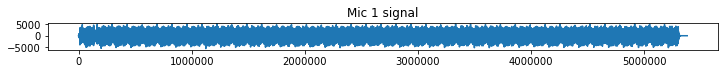

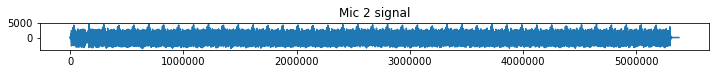

In [47]:
sig_len = len(room.mic_array.signals[0])
Time = np.linspace(0, sig_len / fs, num=sig_len)
samples = np.linspace(0, sig_len, num = sig_len)
# Plot waveforms from each mic
for i in range(room.mic_array.signals.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    # fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.set_title(f'Mic {i} signal')
    # ax.plot(Time, room.mic_array.signals[i,:])
    # ax.plot(samples, room.mic_array.signals[i,:])
    ax.plot(room.mic_array.signals[i,:])
plt.show()
# Play 3 seconds of first mic recording
sd.play(room.mic_array.signals[1][:sample_rate*3])

Crop start: 3223709
Samples: 22050


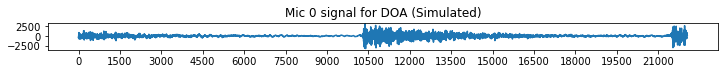

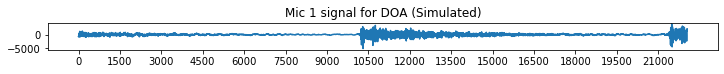

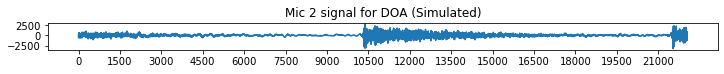

In [80]:
# Cropping signal for DOA
mic_array_signals = []

start = 73.1 # (seconds)
length = 0.5 # (seconds)
# length = 1
mic_array_signals = crop_audio(room.mic_array.signals, start, length)
# Time = np.linspace(0, len(mic_array_signals[0]) / fs, num=len(mic_array_signals[0]))

for i in range(mic_array_signals.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    # fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.set_title(f'Mic {i} signal for DOA (Simulated)')
    ax.set_xticks(np.arange(0, len(mic_array_signals[0])+1, 1500))
    # ax.plot(Time, mic_array_signals [i,:])
    ax.plot(mic_array_signals[i,:])
plt.show()
sd.play(mic_array_signals[2])

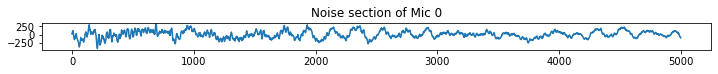

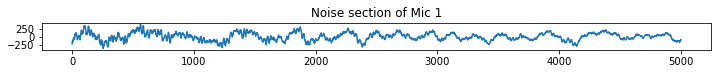

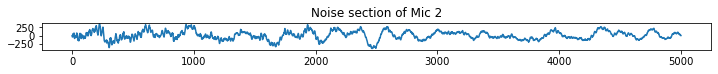

In [81]:
#Noise sections
noise_start = 5000
noise_end = 10000
noise_len = noise_end-noise_start

mic_noise = np.zeros((3, noise_len))
# Time = np.linspace(0, len(mic_noise[0]) / fs, num=len(mic_noise[0]))
for i in range(mic_array_signals.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    # fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.set_title(f'Noise section of Mic {i}')
    # ax.set_xticks(np.arange(0, noise_len+1, 1500))
    mic_noise[i] = mic_array_signals[i][noise_start:noise_end]
    ax.plot(mic_noise[i])
    # ax.plot(Time, mic_noise[i])
plt.show()
# plt.plot(noise1)

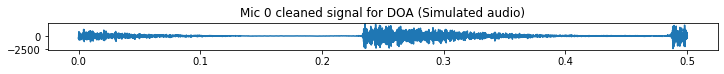

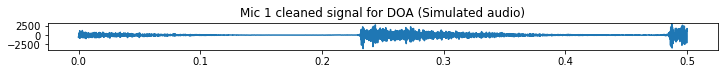

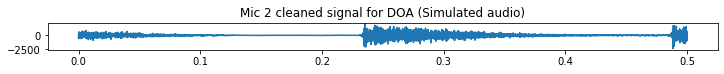

In [82]:
#Noise removal
sig_len = mic_array_signals.shape[1]
Time = np.linspace(0, sig_len / fs, num=sig_len)
for i in range(mic_array_signals.shape[0]):
    mic_array_signals[i] = nr.reduce_noise(mic_array_signals[i], mic_noise[i])
    fig = plt.figure(figsize=(12, 0.5))
    ax = fig.add_subplot(111)
    # ax.set_xticks(np.arange(0, len(mic_array_signals[0])+1, 1500))
    ax.set_title(f'Mic {i} cleaned signal for DOA (Simulated audio)')
    # ax.plot(mic_array_sig[i,:][10000:13500])
    ax.plot(Time, mic_array_signals[i])
plt.show()
sd.play(mic_array_signals[2])

In [83]:
#Computing STFT's
# nfft = 512
nfft = 256
X = np.array([pra.transform.stft.analysis(sig, nfft, nfft // 2).T for sig in mic_array_signals])
# i = 0
# for x in X:
#     # fig = plt.figure(figsize=(14, 2))
#     fig = plt.figure()
#     ax = fig.add_subplot(111)
#     ax.imshow(np.absolute(x), cmap='inferno', origin='lower', aspect='auto')
#     print(x.shape)
#     ax.set_title(f'STFT of sig {i}')
#     i += 1

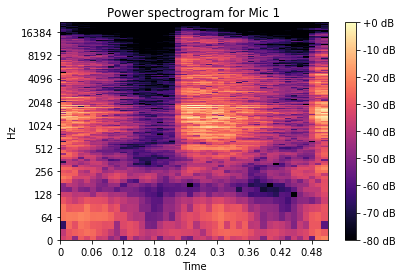

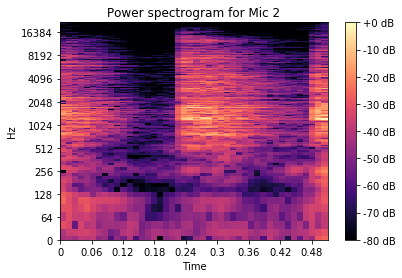

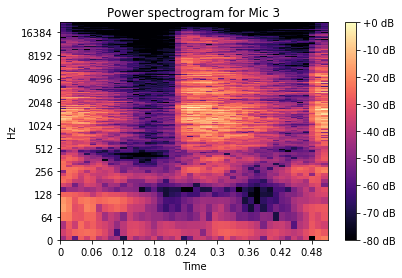

In [86]:
# fig, axs = plt.subplots(3, 1, constrained_layout=True)
for i in range(mic_array_signals.shape[0]):
    s = librosa.stft(mic_array_signals[i])
    fig, ax = plt.subplots()
    img = librosa.display.specshow(librosa.amplitude_to_db(s,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax, sr=fs)
    ax.set_title(f'Power spectrogram for Mic {i+1}')
    fig.colorbar(img, ax=ax, format="%+2.0f dB")
    plt.show()


No handles with labels found to put in legend.
SRP


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




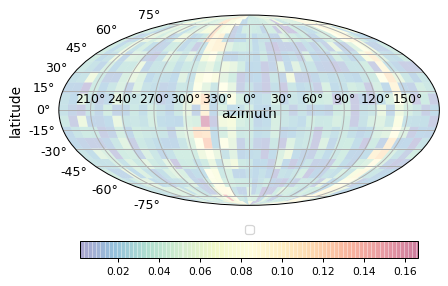

No handles with labels found to put in legend.
Real azimuth (deg): 311
Estimated azimuth (deg): 311.9488006716768
Estimated elevation (deg): -8.453111964403103
MUSIC


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




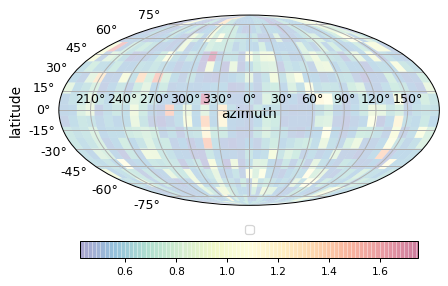

Real azimuth (deg): 311
Estimated azimuth (deg): 314.1848470825851
Estimated elevation (deg): -46.302724700369495
TOPS
No handles with labels found to put in legend.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




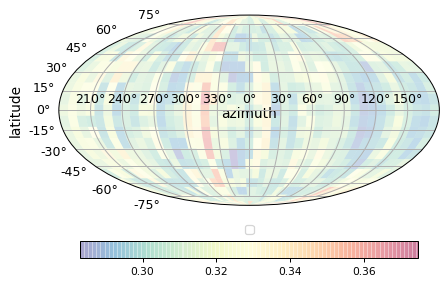

Real azimuth (deg): 311
Estimated azimuth (deg): 137.50776405003785
Estimated elevation (deg): 85.56077772515714
CSSM
No handles with labels found to put in legend.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




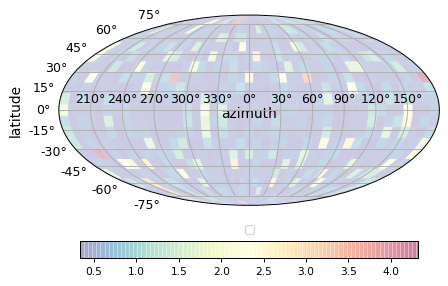

Real azimuth (deg): 311
Estimated azimuth (deg): 170.82303752838385
Estimated elevation (deg): -30.066181550045002


In [87]:
algo_names = ['SRP', 'MUSIC', 'TOPS', 'CSSM']
spatial_resp = dict()

c = 343
# freq_range = [300, 1500]
freq_range = [512, 3500]


for algo_name in algo_names:
    print(algo_name)
    doa = pra.doa.algorithms[algo_name](R, 
                  44100, 
                  nfft, 
                  c=c, 
                  num_src=1, 
                  dim=3, 
                  n_grid=1000)

    doa.locate_sources(X, freq_range=freq_range)

    # Find direction of maximum energy
    max_idx = doa.grid.find_peaks(k=1)[0]

    # Get maximum azimuth angle
    max_az = doa.grid.azimuth[max_idx]
    if max_az < 0:
        max_az += 2 * np.pi

    # Get maximum elevation angle
    max_el = doa.grid.colatitude[max_idx]
    max_el -= np.pi / 2
    doa.grid.plot()
    plt.show()
    
    print('Real azimuth (deg):', real_azimuth)
    print('Estimated azimuth (deg):', max_az * (180 / np.pi))
    print('Estimated elevation (deg):', max_el * (180 / np.pi))

# Real Audio

In [127]:
# mic_1 = "./SyncRecordings/rec_from_src/192.168.49.1_sync.wav"
# mic_2 = "./SyncRecordings/rec_from_src/192.168.49.200:38218_sync.wav"
# mic_3 = "./SyncRecordings/rec_from_src/192.168.49.201:55614_sync.wav"

mic_1 = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.1_sync.wav"
mic_2 = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.200_40404_sync.wav"
mic_3 = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.201_57062_sync.wav"

mic1_ns = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.1.wav"
mic2_ns = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.200_40404.wav"
mic3_ns = "./SyncRecordings/rec_from_src_usb_mic/192.168.49.201_57062.wav"

fs, sig_1 = wavfile.read(mic_1)
fs, sig_2 = wavfile.read(mic_2)
fs, sig_3 = wavfile.read(mic_3)

fs, sig1_ns = wavfile.read(mic1_ns)
fs, sig2_ns = wavfile.read(mic2_ns)
fs, sig3_ns = wavfile.read(mic3_ns)

# print(len(sig_1))

array_signals = np.zeros((3, len(sig_1)))
array_sigs_ns = np.zeros((3, len(sig1_ns)))

array_signals[0] = sig_1
array_signals[1] = sig_2
array_signals[2] = sig_3

array_sigs_ns[0] = sig1_ns
array_sigs_ns[1] = sig2_ns
array_sigs_ns[2] = sig3_ns


mic_array_sig = []
# mic_array_sig = keep_last(array_signals, 0.5)
# start = 73.1 #(seconds)
# length = 0.5#(seconds)

start = 10 #(seconds)
length = 0.9 #(seconds)
mic_array_sig = crop_audio(array_signals, start, length)

mic_array_sig_ns = crop_audio(array_sigs_ns, start, length)

Crop start: 441000
Samples: 39690
Crop start: 441000
Samples: 39690


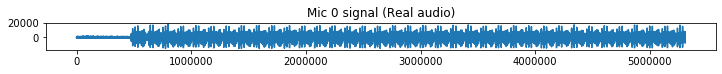

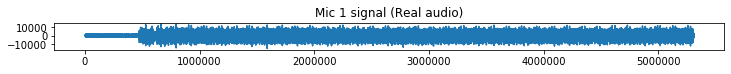

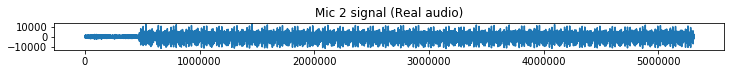

In [89]:
# Plot waveforms from each mic
for i in range(array_signals.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    ax = fig.add_subplot(111)
    ax.set_title(f'Mic {i} signal (Real audio)')
    ax.plot(array_signals[i,:])
plt.show()
# Play 3 seconds of first mic recording
sd.play(array_signals[1][:sample_rate*3])

In [17]:
len(array_signals[0])

5308416

39690
39690
39690


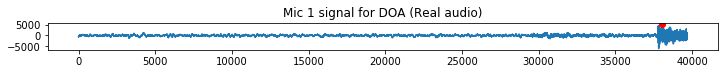

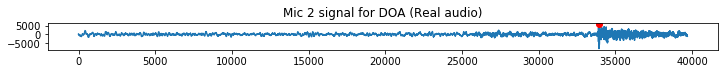

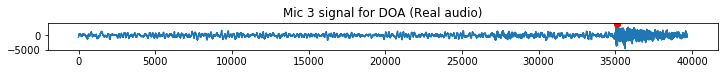

Experimental delays:
t23 = 26.53061224489796 (ms)
t21 = 92.8344671201814 (ms)
Expected delays:
t23 = 2.011661807580175 (ms)
t21 = 2.011661807580175 (ms)
-------------------------------------------
NON-SYCHRONIZED SIGNALS


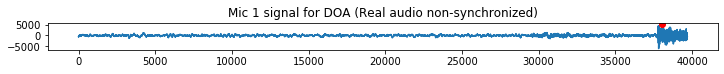

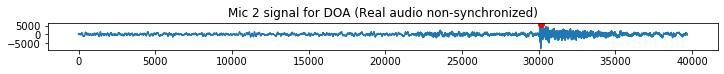

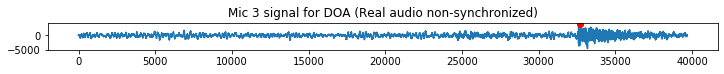

t23 = 57.12018140589569 (ms)
t21 = 179.0249433106576 (ms)


In [128]:
sig_len = len(mic_array_sig[0])
Time = np.linspace(0, sig_len/ fs, num=sig_len)
t = np.zeros((3,1))
for i in range(mic_array_sig.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    # fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.set_title(f'Mic {i+1} signal for DOA (Real audio)')
    print(sig_len)
    # ax.set_xticks(np.arange(0, len(Time)+1, 0.1))
    # ax.set_xticks(np.arange(0, sig_len+1, 1500))
    ax.plot(mic_array_sig[i,:])
    max_arg = np.argmax(mic_array_sig[i,:])
    ax.plot(max_arg, mic_array_sig[i,:][max_arg], 'ro')
    t[i] = max_arg
    # ax.plot(Time, mic_array_sig[i,:])
plt.show()
# sd.play(mic_array_sig[i])

t23 = (t[2]-t[1])[0]*1000/fs
t21 = (t[0]-t[1])[0]*1000/fs

print('Experimental delays:')
print(f't23 = {t23} (ms)')
print(f't21 = {t21} (ms)')
print('Expected delays:')

d23 = 0.69
d21 = 0.69
c = 343
t23_th = d23/c
t21_th = d21/c
print(f't23 = {t23_th*1000} (ms)')
print(f't21 = {t21_th*1000} (ms)')
print('-------------------------------------------')
print('NON-SYCHRONIZED SIGNALS')
t_ns = np.zeros((3,1))
for i in range(mic_array_sig_ns.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    ax = fig.add_subplot(111)
    ax.set_title(f'Mic {i+1} signal for DOA (Real audio non-synchronized)')
    # ax.set_xticks(np.arange(0, len(mic_array_sig_ns[0])+1, 1500))
    ax.plot(mic_array_sig_ns[i,:])
    max_arg = np.argmax(mic_array_sig_ns[i,:])
    ax.plot(max_arg, mic_array_sig_ns[i,:][max_arg], 'ro')
    t_ns[i] = max_arg
plt.show()

t23 = (t_ns[2]-t_ns[1])[0]*1000/fs
t21 = (t_ns[0]-t_ns[1])[0]*1000/fs
print(f't23 = {t23} (ms)')
print(f't21 = {t21} (ms)')


y2 is -171.73902088739956ms behind y1


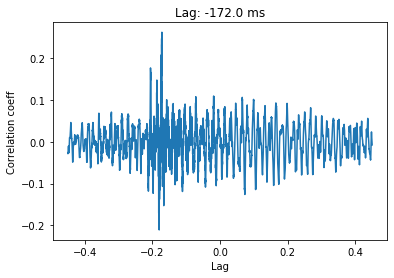

In [137]:
# Cross correlation
def lag_finder(y1, y2, sr):
    n = len(y1)

    corr = signal.correlate(y2, y1, mode='same') / np.sqrt(signal.correlate(y1, y1, mode='same')[int(n/2)] * signal.correlate(y2, y2, mode='same')[int(n/2)])

    delay_arr = np.linspace(-0.5*n/sr, 0.5*n/sr, n)
    delay = delay_arr[np.argmax(corr)]
    print('y2 is ' + str(delay*1000) + 'ms behind y1')

    plt.figure()
    plt.plot(delay_arr, corr)
    plt.title('Lag: ' + str(np.round(delay, 3)*1000) + ' ms')
    plt.xlabel('Lag')
    plt.ylabel('Correlation coeff')
    plt.show()

lag_finder(mic_array_sig_ns[0], mic_array_sig_ns[1], fs)

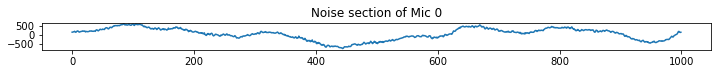

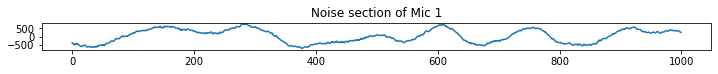

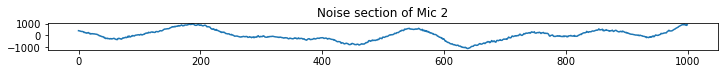

In [130]:
#Noise sections
# noise1 = mic_array_sig[0][10000:14000]
noise_start = 12500
noise_end = 13500

# noise_start = 13500
# noise_end = 15000
noise_len = noise_end-noise_start

mic_noise = np.zeros((3, noise_len))
for i in range(mic_array_sig.shape[0]):
    fig = plt.figure(figsize=(12, 0.5))
    ax = fig.add_subplot(111)
    ax.set_title(f'Noise section of Mic {i}')
    mic_noise[i] = mic_array_sig[i][noise_start:noise_end]
    # ax.plot(mic_array_sig[i,:][10000:13500])
    ax.plot(mic_noise[i])
plt.show()
# plt.plot(noise1)

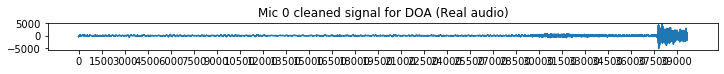

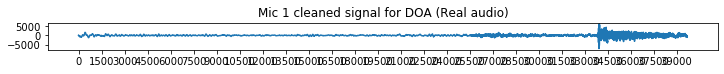

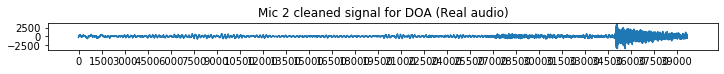

In [131]:
#Noise removal
for i in range(mic_array_sig.shape[0]):
    mic_array_sig[i] = nr.reduce_noise(mic_array_sig[i], mic_noise[i])
    fig = plt.figure(figsize=(12, 0.5))
    ax = fig.add_subplot(111)
    
    ax.set_title(f'Mic {i} cleaned signal for DOA (Real audio)')
    ax.set_xticks(np.arange(0, len(mic_array_sig[0])+1, 1500))
    # ax.plot(mic_array_sig[i,:][10000:13500])
    ax.plot(mic_array_sig[i])
plt.show()
sd.play(mic_array_sig[i])

In [125]:
# Compute and plot STFT for all signals
X = np.array([pra.transform.stft.analysis(sig, nfft, nfft // 2).T for sig in mic_array_sig])

# i = 0
# for x in X:
#     fig = plt.figure(figsize=(14, 2))
#     ax = fig.add_subplot(111)
#     ax.set_title(f'STFT of sig {i}')
#     ax.imshow(np.absolute(x), cmap='inferno', origin='lower', aspect='auto')
#     i+=1

/home/pascal/.local/lib/python3.8/site-packages/librosa/core/spectrum.py:1641: UserWarning:

amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.



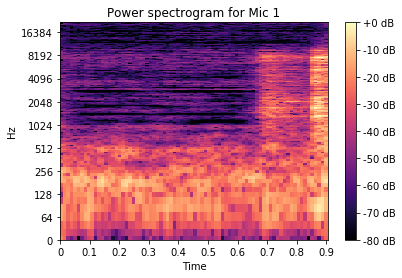

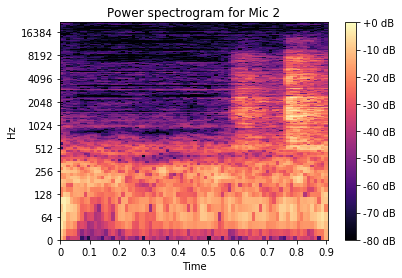

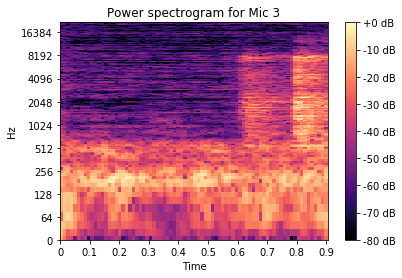

In [132]:
# fig, axs = plt.subplots(3, 1, constrained_layout=True)
for i in range(mic_array_sig.shape[0]):
    s = librosa.stft(mic_array_sig[i])
    fig, ax = plt.subplots()
    img = librosa.display.specshow(librosa.amplitude_to_db(s,
                                                       ref=np.max),
                               y_axis='log', x_axis='time', ax=ax, sr=fs)
    ax.set_title(f'Power spectrogram for Mic {i+1}')
    fig.colorbar(img, ax=ax, format="%+2.0f dB")
    plt.show()

No handles with labels found to put in legend.
SRP


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




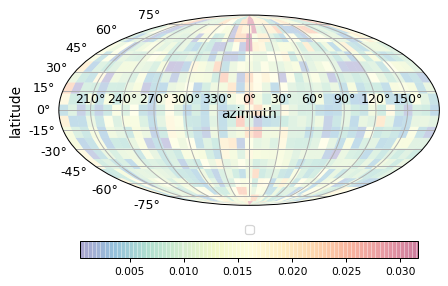

No handles with labels found to put in legend.
Real azimuth (deg): 311
Estimated azimuth (deg): 359.04509418190173
Estimated elevation (deg): -43.39309951962295
MUSIC


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




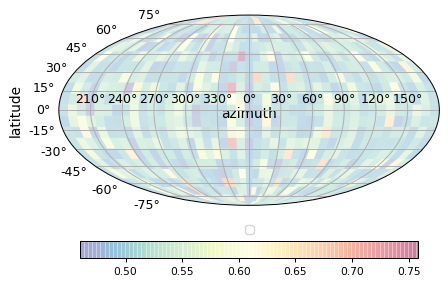

Real azimuth (deg): 311
Estimated azimuth (deg): 346.6460268323953
Estimated elevation (deg): -45.47953077146424
TOPS
No handles with labels found to put in legend.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




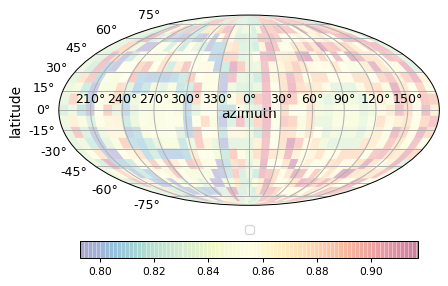

Real azimuth (deg): 311
Estimated azimuth (deg): 35.815249366159684
Estimated elevation (deg): 8.337279188905693
CSSM
No handles with labels found to put in legend.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


/home/pascal/.local/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:405: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




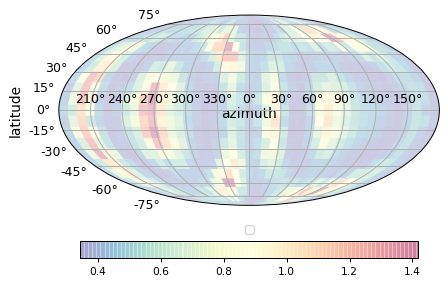

Real azimuth (deg): 311
Estimated azimuth (deg): 262.35253127365104
Estimated elevation (deg): -14.536694915167695


In [135]:
algo_names = ['SRP', 'MUSIC', 'TOPS', 'CSSM']
c = 343
# freq_range = [300, 1500]
freq_range = [512, 3500]


for algo_name in algo_names:
    print(algo_name)
    doa = pra.doa.algorithms[algo_name](R, 
                  44100, 
                  nfft, 
                  c=c, 
                  num_src=1, 
                  dim=3, 
                  n_grid=1000)

    doa.locate_sources(X, freq_range=freq_range)

    # Find direction of maximum energy
    max_idx = doa.grid.find_peaks(k=1)[0]

    # Get maximum azimuth angle
    max_az = doa.grid.azimuth[max_idx]
    if max_az < 0:
        max_az += 2 * np.pi

    # Get maximum elevation angle
    max_el = doa.grid.colatitude[max_idx]
    max_el -= np.pi / 2
    doa.grid.plot()
    plt.show()

    print('Real azimuth (deg):', real_azimuth)
    print('Estimated azimuth (deg):', max_az * (180 / np.pi))
    print('Estimated elevation (deg):', max_el * (180 / np.pi))